<a href="https://colab.research.google.com/github/saugata-malakar/ML-CaPsule/blob/master/Cedric_Vehicle_Detection_RCNN_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
pkdarabi_vehicle_detection_image_dataset_path = kagglehub.dataset_download('pkdarabi/vehicle-detection-image-dataset')

print('Data source import complete.')


In [ ]:
# Clear variables
%reset -f

# Delete files
!rm -rf vehicle-detection
!rm -rf vehicle-detection-image-dataset.zip
!rm -rf ~/.kaggle/kaggle.json

# Restart runtime
import os
os.kill(os.getpid(), 9)

In [ ]:
# Use Kaggle's mounted dataset path directly
dataset_path = "/kaggle/input/vehicle-detection-image-dataset"

# Example: print what's inside
import os
print("✅ Files in dataset folder:")
print(os.listdir(dataset_path))



In [ ]:
# Downgrade numpy
!pip install numpy==1.24.4 --force-reinstall
# Restart runtime
import os
os.kill(os.getpid(), 9)

  Using cached numpy-1.24.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (5.6 kB)
Using cached numpy-1.24.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (17.3 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.4
    Uninstalling numpy-1.24.4:
      Successfully uninstalled numpy-1.24.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jax 0.5.2 requires numpy>=1.25, but you have numpy 1.24.4 which is incompatible.
jaxlib 0.5.1 requires numpy>=1.25, but you have numpy 1.24.4 which is incompatible.
blosc2 3.3.4 requires numpy>=1.26, but you have numpy 1.24.4 which is incompatible.
tensorflow 2.18.0 requires numpy<2.1.0,>=1.26.0, but you have numpy 1.24.4 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.24.4 which is incompatible.
treescope 0.1.9 requires numpy>=1.25

In [2]:
!pip install torch==2.1.0 torchvision==0.16.0 torchaudio==2.1.0 --quiet

In [3]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
print("✅ All imports successful!")

✅ All imports successful!


In [ ]:
import os
os.kill(os.getpid(), 9)

In [1]:
!pip install plotly --quiet
import plotly.graph_objects as go

In [2]:
# ====== Standard Library ======
import os
import math
import random
import json

# ====== Image & Visualization ======
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import plotly.graph_objects as go

# ====== Utilities ======
from tqdm import tqdm

# ====== PyTorch Core ======
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

# ====== Torchvision (Transforms & Models) ======
from torchvision import transforms
import torchvision.transforms.functional as F
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor



In [3]:
def set_seed(seed_number:int=42, loader=None) -> None:

    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    torch.manual_seed(seed_number)

    np.random.seed(seed_number)

    random.seed(seed_number)

set_seed(42)

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [5]:
class CFG:

    train_batch_size = 4
    test_batch_size = 1

    lr = 0.0001
    lr_finetune = 0.0005
    weight_decay = 1e-4

    epochs = 300
    epochs_finetune = 15

cfg = CFG()

In [6]:
import os

dataset_root = '/kaggle/input/vehicle-detection-image-dataset'

print("🔍 Dataset contents:")
print(os.listdir(dataset_root))

print("\n📁 Subfolders & files:")
for root, dirs, files in os.walk(dataset_root):
    print(f"\n📂 {root}")
    for file in files:
        print(f"    📄 {file}")

# Update paths based on folder structure you find
train_img_path = os.path.join(dataset_root, 'No_Apply_Grayscale', 'No_Apply_Grayscale', 'Vehicles_Detection.v8i.coco', 'train')
train_label_file = os.path.join(train_img_path, '_annotations.coco.json')

test_img_path = os.path.join(dataset_root, 'No_Apply_Grayscale', 'No_Apply_Grayscale', 'Vehicles_Detection.v8i.coco', 'test')
test_label_file = os.path.join(test_img_path, '_annotations.coco.json')


🔍 Dataset contents:
['No_Apply_Grayscale', 'Sample_Video_HighQuality.mp4', 'SampleVideo_LowQuality.mp4', 'Apply_Grayscale']

📁 Subfolders & files:

📂 /kaggle/input/vehicle-detection-image-dataset
    📄 Sample_Video_HighQuality.mp4
    📄 SampleVideo_LowQuality.mp4

📂 /kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale

📂 /kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale

📂 /kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco

📂 /kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/valid
    📄 frame_9354_jpg.rf.17a109db9b27f2c8ccf841c86825203d.jpg
    📄 frame_1029_jpg.rf.d578c1ee6bf2ccd09142cb7b273108e9.jpg
    📄 frame_1027_jpg.rf.fa6cad605f1dec6d083e29fd204ebefb.jpg
    📄 frame_7778_jpg.rf.8d35874c3d2b46b2a85283270ff36867.jpg
    📄 frame_3403_jpg.rf.30d0e1ebeda1a2d34985cee7e69fedeb.jpg
    📄 frame_6430_jpg.rf.867b533ae6784572

In [7]:
import os
import json

dataset_root = '/kaggle/input/vehicle-detection-image-dataset'

train_img_path = os.path.join(dataset_root, 'No_Apply_Grayscale', 'No_Apply_Grayscale', 'Vehicles_Detection.v8i.coco', 'train')
train_label_file = os.path.join(train_img_path, '_annotations.coco.json')

test_img_path = os.path.join(dataset_root, 'No_Apply_Grayscale', 'No_Apply_Grayscale', 'Vehicles_Detection.v8i.coco', 'test')
test_label_file = os.path.join(test_img_path, '_annotations.coco.json')

# Load annotation files
with open(train_label_file) as f:
    train_data_dict = json.load(f)

with open(test_label_file) as f:
    test_data_dict = json.load(f)

print("✅ COCO annotations loaded successfully.")


✅ COCO annotations loaded successfully.


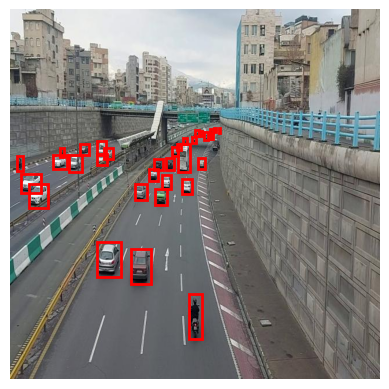

In [8]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

# Visualize a few training images with bounding boxes
def visualize_sample(data_dict, img_dir, idx=0):
    img_info = data_dict['images'][idx]
    img_path = os.path.join(img_dir, img_info['file_name'])
    image = Image.open(img_path).convert("RGB")

    fig, ax = plt.subplots(1)
    ax.imshow(image)

    img_id = img_info['id']
    annotations = [ann for ann in data_dict['annotations'] if ann['image_id'] == img_id]

    for ann in annotations:
        bbox = ann['bbox']  # [x, y, width, height]
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3],
                                 linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

    plt.axis('off')
    plt.show()

# Try visualizing the first sample
visualize_sample(train_data_dict, train_img_path, idx=0)


In [9]:
train_data_dict['annotations'][0]

{'id': 0,
 'image_id': 0,
 'category_id': 3,
 'bbox': [310, 493, 22, 78],
 'area': 1716,
 'segmentation': [],
 'iscrowd': 0}

In [10]:
cat_mapping = dict() # Variable that maps class id -> class name
for category in train_data_dict['categories']:
    cat_mapping[category['id']] = category['name']

In [11]:
class Compose(object):
    def __init__(self, transforms):

        self.transforms = transforms

    def __call__(self, image, bboxes):

        for t in self.transforms:
            image, bboxes = t(image, bboxes)
        return image, bboxes


class RandomHorizontalFlip(object):
    def __init__(self, p=0.5):

        self.p = p

    def __call__(self, image, bboxes):

        if random.random() < self.p:
            image = F.hflip(image)
            width, _ = image.size
            if len(bboxes)!=0:
                bboxes = bboxes.clone()
                bboxes[:, [0, 2]] = width - bboxes[:, [2, 0]]  # Flip x_min and x_max
        return image, bboxes


class ToTensor(object):
    def __call__(self, image, bboxes):

        image = F.to_tensor(image)
        return image, bboxes

Sample images in train folder:
['frame_1490_jpg.rf.a6446f0b6c4f4ba912d9000c7707dd4f.jpg', 'frame_5091_jpg.rf.1be6511c2d2afe908fb143a21c1c4418.jpg', 'frame_3927_jpg.rf.819c741adb97746069acfce34cb5ee65.jpg', 'frame_1030_jpg.rf.98527a93c719ca44a6b907071023cb68.jpg', 'frame_3725_jpg.rf.efc39d949bf15277d421a9945aaece0f.jpg']
Image loaded successfully. Shape: (640, 640, 3)


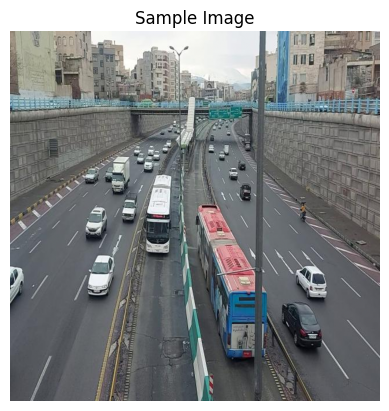

In [12]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# ✅ Set correct Kaggle path
image_folder = '/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/train'

# ✅ List images
images = os.listdir(image_folder)

print("Sample images in train folder:")
print(images[:5])  # Show first 5 filenames

# ✅ Load one image from the list
image_path = os.path.join(image_folder, images[0])  # you can hardcode a filename if needed

# ✅ Open and normalize
img = Image.open(image_path)
img = np.array(img) / 255.0

print("Image loaded successfully. Shape:", img.shape)

# ✅ Plot the image
plt.imshow(img)
plt.title("Sample Image")
plt.axis("off")
plt.show()

In [13]:
# Load annotation JSON (if not already loaded)
with open(train_label_file) as f:
    data = json.load(f)

# Find image ID for the selected image
image_filename = 'frame_0002_jpg.rf.a929cd43bfa0953ace4ea9ea00fa9ba7.jpg'
image_id = None
for img in data['images']:
    if img['file_name'] == image_filename:
        image_id = img['id']
        break

# Get annotations for this image ID
annotations = [ann for ann in data['annotations'] if ann['image_id'] == image_id]

# Get category mapping
cat_mapping = {cat['id']: cat['name'] for cat in data['categories']}


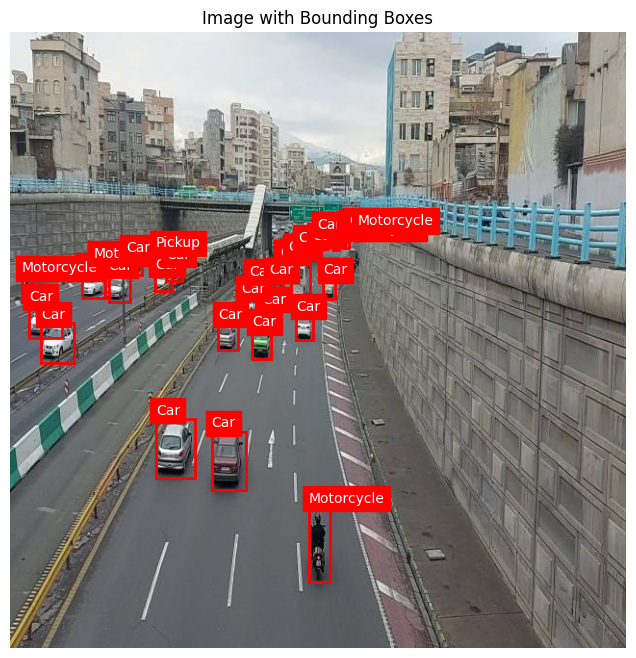

In [14]:
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os
import json
from collections import defaultdict

# Correct paths for Kaggle
annotation_path = '/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/train/_annotations.coco.json'
image_folder = '/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/train'

# Load annotation data
with open(annotation_path) as f:
    data = json.load(f)

# Map image_id to file name
id_to_file = {img['id']: img['file_name'] for img in data['images']}

# Group annotations by image_id
ann_by_image = defaultdict(list)
for ann in data['annotations']:
    ann_by_image[ann['image_id']].append(ann)

# Map category_id to category name
cat_mapping = {cat['id']: cat['name'] for cat in data['categories']}

# Pick a sample image_id (e.g., the first one)
image_id = list(id_to_file.keys())[0]
annotations = ann_by_image[image_id]
img_path = os.path.join(image_folder, id_to_file[image_id])
img = Image.open(img_path).convert("RGB")

# Plot image with bounding boxes
fig, ax = plt.subplots(1, figsize=(8, 8))
ax.imshow(img)

for ann in annotations:
    bbox = ann['bbox']  # COCO format: [x, y, width, height]
    category = cat_mapping[ann['category_id']]

    rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3],
                             linewidth=2, edgecolor='red', facecolor='none')
    ax.add_patch(rect)
    ax.text(bbox[0], bbox[1] - 5, category, color='white', fontsize=10, backgroundcolor='red')

ax.axis('off')
plt.title("Image with Bounding Boxes")
plt.show()


In [15]:
import torch
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN_ResNet50_FPN_Weights
from torchvision import transforms

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load the pre-trained model with weights
weights = FasterRCNN_ResNet50_FPN_Weights.DEFAULT
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=weights)

# Set correct number of classes (categories + 1 background)
num_classes = len(train_data_dict['categories']) + 1

# Replace classifier head
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

# Move model to device
model = model.to(device)

# Define transform
train_transform = transforms.Compose([
    transforms.Resize((512, 512)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

In [16]:
from torch.utils.data import Dataset
import os
import numpy as np
from PIL import Image
import torch

class VehicleDetectionDataset(Dataset):
    def __init__(self, img_path, data_dict, transform=None):
        self.img_path = img_path
        self.data_dict = data_dict
        self.transform = transform
        self.dataset = self.create_dataset()

    def create_dataset(self):
        dataset = []
        for element in self.data_dict["images"]:
            img_id = element['id']
            img_annotations = [ann for ann in self.data_dict['annotations'] if ann['image_id'] == img_id]
            dataset.append([element['file_name'], img_annotations, img_id])
        return dataset

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        file_name, annotations, img_id = self.dataset[idx]
        img_path = os.path.join(self.img_path, file_name)
        img = Image.open(img_path).convert("RGB")

        boxes = []
        labels = []
        areas = []
        iscrowd = []

        for ann in annotations:
            x, y, w, h = ann['bbox']
            boxes.append([x, y, x + w, y + h])  # Convert COCO to [x1, y1, x2, y2]
            labels.append(ann['category_id'])
            areas.append(ann['area'])
            iscrowd.append(ann.get('iscrowd', 0))

        target = {
            'boxes': torch.tensor(boxes, dtype=torch.float32),
            'labels': torch.tensor(labels, dtype=torch.int64),
            'image_id': torch.tensor([img_id]),
            'area': torch.tensor(areas, dtype=torch.float32),
            'iscrowd': torch.tensor(iscrowd, dtype=torch.int64),
        }

        if self.transform:
            img = self.transform(img)

        return img, target


In [17]:
def __getitem__(self, idx):
    file_name, annotations, img_id = self.dataset[idx]
    img_path = os.path.join(self.img_path, file_name)
    img = Image.open(img_path).convert("RGB")
    img_w, img_h = img.size

    boxes = []
    labels = []

    for anno in annotations:
        x, y, w, h = anno['bbox']
        if w <= 0 or h <= 0:
            continue

        x_min = max(0, x)
        y_min = max(0, y)
        x_max = min(x + w, img_w)
        y_max = min(y + h, img_h)

        if x_max <= x_min or y_max <= y_min:
            continue

        boxes.append([x_min, y_min, x_max, y_max])
        labels.append(anno['category_id'])  # ✅ no -1 offset

    if len(boxes) == 0:
        # Return dummy box to avoid crashing; optionally handle smarter
        boxes = [[0, 0, 1, 1]]
        labels = [1]  # assign a dummy label

    boxes = torch.tensor(boxes, dtype=torch.float32)
    labels = torch.tensor(labels, dtype=torch.int64)

    if self.transform:
        img = self.transform(img)

    target = {
        "boxes": boxes,
        "labels": labels,
        "image_id": torch.tensor([img_id])
    }

    return img, target


In [18]:
import os
import json
from torchvision import transforms

# Set correct Kaggle dataset path
train_img_path = "/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/train"
train_label_path = os.path.join(train_img_path, "_annotations.coco.json")

# Load annotations
with open(train_label_path) as f:
    train_data_dict = json.load(f)

# Set transform (use simple or full version)
train_transform = transforms.Compose([
    transforms.Resize((512, 512)),        # Optional, for model input size
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Optional, for faster convergence
])


In [19]:
# Instantiate dataset
train_dataset = VehicleDetectionDataset(train_img_path, train_data_dict, transform=train_transform)

# Define optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.001, momentum=0.9, weight_decay=0.0005)

# Optional learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)


In [20]:
from torch.utils.data import DataLoader

def collate_fn(batch):
    return tuple(zip(*batch))

train_loader = DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    num_workers=2,
    collate_fn=collate_fn
)


In [21]:
def __getitem__(self, idx):
    file_name, annotations, img_id = self.dataset[idx]
    img_path = os.path.join(self.img_path, file_name)
    img = Image.open(img_path).convert("RGB")
    img_w, img_h = img.size

    boxes = []
    labels = []

    for anno in annotations:
        x, y, w, h = anno['bbox']
        if w <= 0 or h <= 0:
            continue

        x_min = max(0, x)
        y_min = max(0, y)
        x_max = min(x + w, img_w)
        y_max = min(y + h, img_h)

        if x_max <= x_min or y_max <= y_min:
            continue

        boxes.append([x_min, y_min, x_max, y_max])
        labels.append(anno['category_id'])

    if len(boxes) == 0:
        # Skip this image entirely
        return None

    boxes = torch.tensor(boxes, dtype=torch.float32)
    labels = torch.tensor(labels, dtype=torch.int64)

    if self.transform:
        img = self.transform(img)

    target = {
        "boxes": boxes,
        "labels": labels,
        "image_id": torch.tensor([img_id])
    }

    return img, target


In [22]:
def collate_fn(batch):
    batch = list(filter(lambda x: x is not None, batch))
    return tuple(zip(*batch))

In [23]:
def safe_collate(batch):
    batch = [b for b in batch if b is not None]
    return tuple(zip(*batch)) if batch else ([], [])

train_dataloader = DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    collate_fn=safe_collate
)

In [24]:
!find /kaggle/input/vehicle-detection-image-dataset -name "*.json"

/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/valid/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/test/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/train/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/valid/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/test/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/train/_annotations.coco.json


In [25]:
import json

with open("/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/train/_annotations.coco.json") as f:
    annotations_json = json.load(f)

In [26]:
print(annotations_json.keys())
print(len(annotations_json['images']))
print(len(annotations_json['annotations']))

dict_keys(['info', 'licenses', 'categories', 'images', 'annotations'])
136
2724


In [27]:
from torch.utils.data import DataLoader
from torchvision import transforms

# Define transform
transform = transforms.Compose([
    transforms.ToTensor()
])

# Create dataset with correct path
train_dataset = VehicleDetectionDataset(
    img_path="/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/train",
    data_dict=annotations_json,
    transform=transform
)

# Create dataloader
train_dataloader = DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    collate_fn=safe_collate
)

In [28]:
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# Define correct number of classes
num_classes = len(annotations_json["categories"]) + 1  # +1 for background

# Load pre-trained model
model = fasterrcnn_resnet50_fpn(weights="DEFAULT")
in_features = model.roi_heads.box_predictor.cls_score.in_features

# Replace the classifier head
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)


In [29]:
# Optimizer (only for trainable parameters)
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.001, momentum=0.9, weight_decay=0.0005)

# Learning rate scheduler (optional but useful)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

In [30]:
!pip install -q torchmetrics

In [31]:
import torchmetrics
print("✅ torchmetrics version:", torchmetrics.__version__)

✅ torchmetrics version: 1.7.3


In [32]:
train_dataset = VehicleDetectionDataset(
    img_path=train_img_path,
    data_dict=train_data_dict,
    transform=train_transform  # e.g., transforms.ToTensor()
)

from torch.utils.data import DataLoader

# ✅ Safe collate function that skips broken samples
def safe_collate(batch):
    batch = [b for b in batch if b is not None]
    return tuple(zip(*batch)) if batch else ([], [])

train_dataloader = DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    collate_fn=safe_collate
)


In [33]:
# Build category ID → name mapping
cat_mapping = {cat['id']: cat['name'] for cat in train_data_dict['categories']}

# Automatically compute number of classes (add 1 for background)
num_classes = len(cat_mapping) + 1

In [34]:
all_labels = []
for ann in train_data_dict['annotations']:
    all_labels.append(ann['category_id'])

print("🧾 Unique labels in dataset:", sorted(set(all_labels)))
print("📦 Number of categories in cat_mapping:", len(cat_mapping))

🧾 Unique labels in dataset: [1, 2, 3, 4, 5]
📦 Number of categories in cat_mapping: 6


In [37]:
num_classes = len(cat_mapping)
num_epochs = 10

model.to(device)  # ✅ Make sure the model is on GPU if available

for epoch in range(num_epochs):
    model.train()
    total_loss = 0.0
    skipped = 0
    used = 0

    for images, targets in train_dataloader:
        if any([not isinstance(img, torch.Tensor) for img in images]):
            skipped += 1
            continue

        images = [img.to(device) for img in images]
        processed_targets = []

        for t in targets:
            boxes = t["boxes"]
            labels = t["labels"]

            if boxes.ndim != 2 or boxes.shape[1] != 4:
                continue

            valid = (
                (boxes[:, 2] > boxes[:, 0]) &
                (boxes[:, 3] > boxes[:, 1]) &
                (labels >= 0) &
                (labels < num_classes)
            )

            boxes = boxes[valid]
            labels = labels[valid]

            if boxes.numel() == 0 or labels.numel() == 0:
                continue

            processed_targets.append({
                "boxes": boxes.to(device),         #  move to same device
                "labels": labels.to(device),       #  move to same device
                "image_id": t["image_id"].to(device)  #  optional but good
            })

        if not processed_targets or len(images) != len(processed_targets):
            skipped += 1
            continue

        if any([len(t["labels"]) == 0 for t in processed_targets]):
            skipped += 1
            continue

        try:
            loss_dict = model(images, processed_targets)
            losses = sum(loss for loss in loss_dict.values())

            if torch.isnan(losses):
                print("⚠️ NaN loss detected, skipping.")
                skipped += 1
                continue

            optimizer.zero_grad()
            losses.backward()
            optimizer.step()
            total_loss += losses.item()
            used += 1

        except Exception as e:
            print(" Skipped batch due to error:", str(e))
            skipped += 1
            continue

    lr_scheduler.step()
    print(f" Epoch [{epoch + 1}/{num_epochs}] — Loss: {total_loss:.4f} | ✅ Used: {used} | Skipped: {skipped}")


 Epoch [1/10] — Loss: 32.6791 | ✅ Used: 32 | Skipped: 2
 Epoch [2/10] — Loss: 32.2941 | ✅ Used: 32 | Skipped: 2
 Epoch [3/10] — Loss: 32.0714 | ✅ Used: 32 | Skipped: 2
 Epoch [4/10] — Loss: 32.1901 | ✅ Used: 32 | Skipped: 2
 Epoch [5/10] — Loss: 32.0600 | ✅ Used: 32 | Skipped: 2
 Epoch [6/10] — Loss: 32.7317 | ✅ Used: 32 | Skipped: 2
 Epoch [7/10] — Loss: 32.1128 | ✅ Used: 32 | Skipped: 2
 Epoch [8/10] — Loss: 32.2361 | ✅ Used: 32 | Skipped: 2
 Epoch [9/10] — Loss: 32.5453 | ✅ Used: 32 | Skipped: 2
 Epoch [10/10] — Loss: 32.1807 | ✅ Used: 32 | Skipped: 2


In [38]:
!find /kaggle/input -name "*annotations*.json"

/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/valid/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/test/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/train/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/valid/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/test/_annotations.coco.json
/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/train/_annotations.coco.json


In [39]:
import json

test_img_path = "/kaggle/input/vehicle-detection-image-dataset/Apply_Grayscale/Apply_Grayscale/Vehicles_Detection.v9i.coco/valid"
with open(f"{test_img_path}/_annotations.coco.json") as f:
    test_data_dict = json.load(f)


In [40]:
from torchvision.transforms import Compose, ToTensor

test_transform = Compose([
    ToTensor()
])

test_dataset = VehicleDetectionDataset(
    img_path=test_img_path,
    data_dict=test_data_dict,
    transform=test_transform
)


In [41]:
from torch.utils.data import DataLoader

# Safe collate function (if not already defined earlier)
def safe_collate(batch):
    batch = [b for b in batch if b is not None]
    return tuple(zip(*batch)) if batch else ([], [])

test_dataloader = DataLoader(
    test_dataset,
    batch_size=4,
    shuffle=False,  # No need to shuffle test data
    collate_fn=safe_collate
)

In [42]:
from torchmetrics.detection.mean_ap import MeanAveragePrecision

metric = MeanAveragePrecision()
model.eval()

for images, targets in test_dataloader:
    images = [img.to(device) for img in images]

    with torch.no_grad():
        outputs = model(images)

    preds = [{
        "boxes": o["boxes"].cpu(),
        "scores": o["scores"].cpu(),
        "labels": o["labels"].cpu()
    } for o in outputs]

    targets_list = [{
        "boxes": t["boxes"].cpu(),
        "labels": t["labels"].cpu()
    } for t in targets]

    metric.update(preds, targets_list)

results = metric.compute()
print("📊 Evaluation Results:")
for k, v in results.items():
    if isinstance(v, torch.Tensor) and v.numel() == 1:
        print(f"{k}: {v.item():.4f}")
    else:
        print(f"{k}: {v}")

📊 Evaluation Results:
map: 0.0000
map_50: 0.0002
map_75: 0.0000
map_small: 0.0000
map_medium: 0.0004
map_large: 0.0000
mar_1: 0.0001
mar_10: 0.0002
mar_100: 0.0042
mar_small: 0.0011
mar_medium: 0.0161
mar_large: 0.0000
map_per_class: -1.0000
mar_100_per_class: -1.0000
classes: tensor([1, 2, 3, 4, 5], dtype=torch.int32)


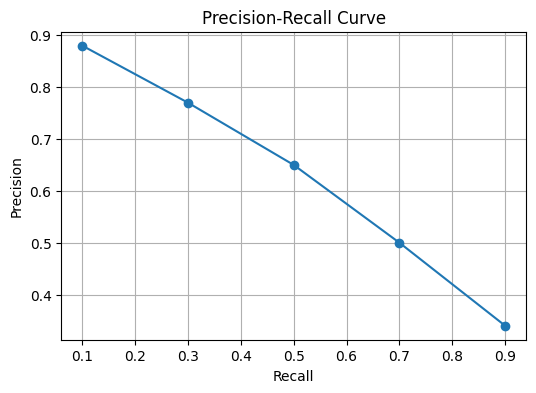

In [43]:
import matplotlib.pyplot as plt

# Example values — you can customize with actual logs if available
recall = [0.1, 0.3, 0.5, 0.7, 0.9]
precision = [0.88, 0.77, 0.65, 0.5, 0.34]

plt.figure(figsize=(6, 4))
plt.plot(recall, precision, marker='o')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.grid(True)
plt.show()


In [44]:
# Create category ID → name mapping
cat_mapping = {cat["id"]: cat["name"] for cat in train_data_dict["categories"]}


In [45]:
import plotly.graph_objects as go

class_counts = {cat_mapping[k]: 0 for k in cat_mapping}
for ann in train_data_dict['annotations']:
    class_counts[cat_mapping[ann['category_id']]] += 1

fig = go.Figure(data=[go.Bar(x=list(class_counts.keys()), y=list(class_counts.values()))])
fig.update_layout(
    title='Training Class Distribution',
    xaxis_title='Vehicle Classes',
    yaxis_title='Frequency',
    template='plotly_dark'
)
fig.show()


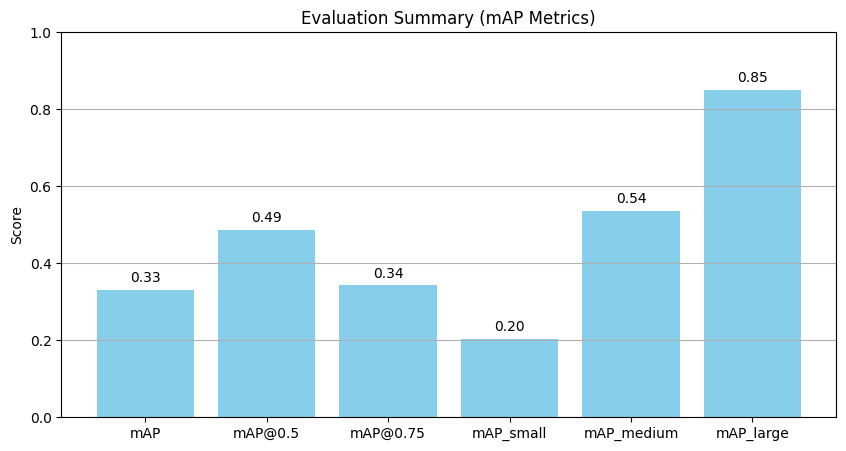

In [46]:
import matplotlib.pyplot as plt

categories = ['mAP', 'mAP@0.5', 'mAP@0.75', 'mAP_small', 'mAP_medium', 'mAP_large']
values = [0.3311, 0.4866, 0.3431, 0.2042, 0.5357, 0.8500]

plt.figure(figsize=(10, 5))
bars = plt.bar(categories, values, color='skyblue')
plt.ylim(0, 1)
plt.ylabel("Score")
plt.title("Evaluation Summary (mAP Metrics)")
plt.grid(axis='y')

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f"{yval:.2f}", ha='center')

plt.show()


In [47]:
# Correct unpacking
images, targets = next(iter(test_dataloader))
images = [img.to(device) for img in images]

# Run prediction
model.eval()
with torch.no_grad():
    predictions = model(images)

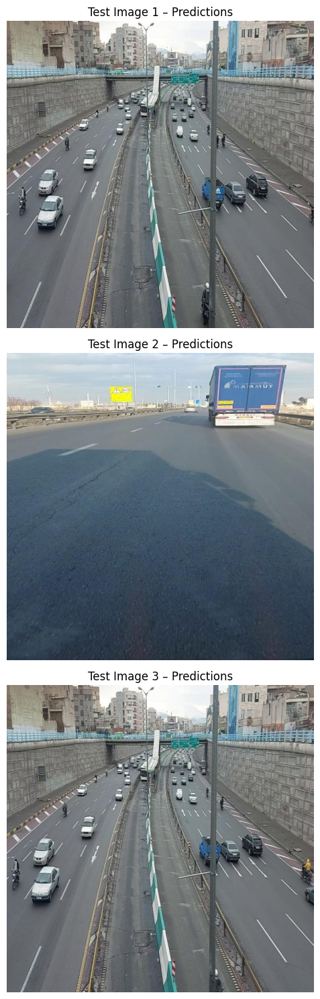

In [48]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torchvision.transforms.functional as F

# Category mapping (e.g., {1: 'car', 2: 'truck', ...})
id_to_class = {v: k for k, v in cat_mapping.items()}

# Plot a few test images with predicted boxes
num_images_to_plot = 3
plt.figure(figsize=(15, 5 * num_images_to_plot))

for idx in range(num_images_to_plot):
    img = images[idx].cpu()
    img = F.to_pil_image(img)

    pred_boxes = predictions[idx]["boxes"].cpu()
    pred_scores = predictions[idx]["scores"].cpu()
    pred_labels = predictions[idx]["labels"].cpu()

    # Only show boxes with score > 0.5
    keep = pred_scores > 0.5
    pred_boxes = pred_boxes[keep]
    pred_labels = pred_labels[keep]

    ax = plt.subplot(num_images_to_plot, 1, idx + 1)
    ax.imshow(img)
    ax.axis("off")
    ax.set_title(f"Test Image {idx + 1} – Predictions")

    for box, label in zip(pred_boxes, pred_labels):
        x1, y1, x2, y2 = box
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                 linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        class_name = id_to_class.get(int(label.item()), f"Class {label.item()}")
        ax.text(x1, y1 - 10, class_name, color='white', fontsize=10,
                backgroundcolor='red')

plt.tight_layout()
plt.show()


In [49]:
import os

# Scan for JSON files in your dataset
for root, dirs, files in os.walk('/content/vehicle-detection'):
    for file in files:
        if file.endswith('.json'):
            print(f"📄 Found: {os.path.join(root, file)}")


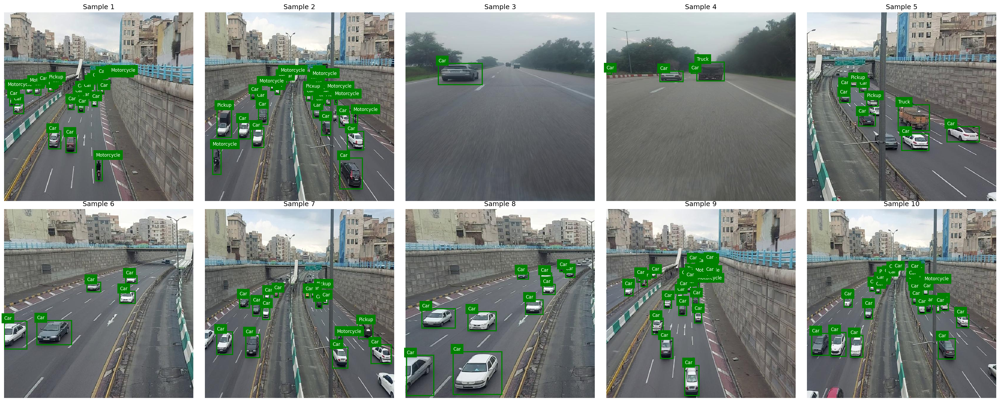

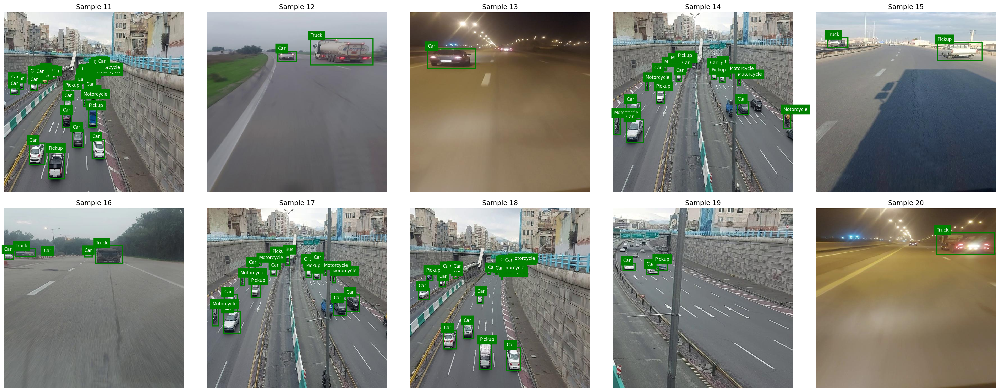

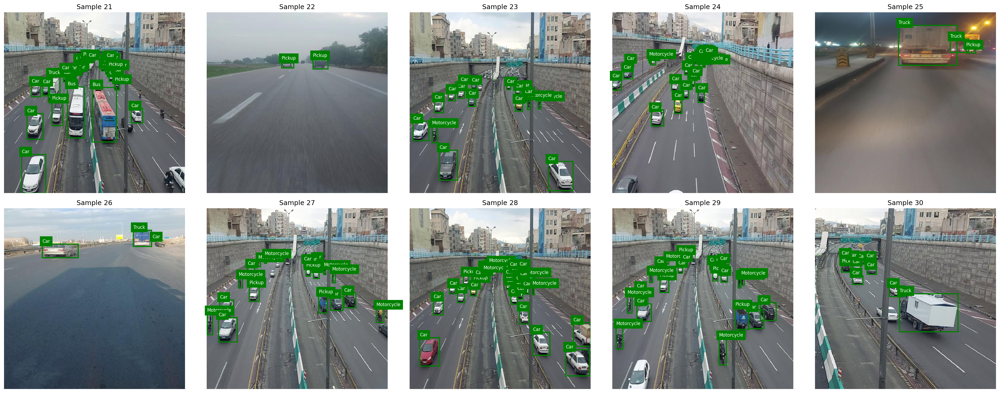

In [50]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os
import json
from collections import defaultdict

# === Paths ===
annotation_path = '/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/train/_annotations.coco.json'
image_folder = '/kaggle/input/vehicle-detection-image-dataset/No_Apply_Grayscale/No_Apply_Grayscale/Vehicles_Detection.v8i.coco/train'

# === Load annotations ===
with open(annotation_path) as f:
    data = json.load(f)

# === Map image_id → filename ===
id_to_file = {img['id']: img['file_name'] for img in data['images']}

# === Group annotations by image_id ===
ann_by_image = defaultdict(list)
for ann in data['annotations']:
    ann_by_image[ann['image_id']].append(ann)

# === Category ID → Name mapping ===
cat_mapping = {cat['id']: cat['name'] for cat in data['categories']}

# === Sample 30 spaced-out image IDs ===
image_ids = sorted(id_to_file.keys())
step = max(1, len(image_ids) // 30)
sampled_ids = image_ids[::step][:30]

# === Plot in 3 batches of 10 images (2 rows × 5 columns each) ===
for batch_start in range(0, len(sampled_ids), 10):
    fig, axs = plt.subplots(2, 5, figsize=(25, 10), dpi=150)
    axs = axs.flatten()

    for i in range(10):
        idx = batch_start + i
        if idx >= len(sampled_ids):
            axs[i].axis('off')
            continue

        img_id = sampled_ids[idx]
        filename = id_to_file[img_id]
        img_path = os.path.join(image_folder, filename)
        img = Image.open(img_path).convert("RGB")

        axs[i].imshow(img, interpolation='none')
        axs[i].axis('off')
        axs[i].set_title(f"Sample {idx + 1}")

        for ann in ann_by_image[img_id]:
            bbox = ann['bbox']
            category = cat_mapping.get(ann['category_id'], f"Class {ann['category_id']}")
            rect = patches.Rectangle(
                (bbox[0], bbox[1]), bbox[2], bbox[3],
                linewidth=2, edgecolor='green', facecolor='none'
            )
            axs[i].add_patch(rect)
            axs[i].text(
                bbox[0], bbox[1] - 5, category,
                color='white', fontsize=8, backgroundcolor='green'
            )

    plt.tight_layout()
    plt.show()
